# Coastal Erosion on the Island of Zanzibar

* **Products used:** 
[gm_s2_annual](https://explorer.digitalearth.africa/gm_s2_annual)

## Background
This is an exploratory notebook to explore the coastal history of Zanzibar and identify any coastal errosiont around the island. 

## Description
A _compulsory_ description of the notebook, including a brief overview of how Digital Earth Africa helps to address the problem set out above.
The overal strategy for exploration is as follows:

1. Load Annual Geomedians downsampled for first and last of all Zanzibar
2. Identify arteas of interest
3. Load Annual Geomedians for first and last years Areas of interest
4. Create MNDWI for time series
5. Create filmstrips or animations

***

## Getting started

Since we are explorting the data it is helpful to get an overview of the island. Luckily the the composites are already computed for each year

### Load packages
Import Python packages that are used for the analysis.

In [3]:
%matplotlib inline

import datacube
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt

from deafrica_tools.dask import create_local_dask_cluster
from deafrica_tools.datahandling import load_ard
from deafrica_tools.plotting import display_map, rgb, map_shapefile, xr_animation
from deafrica_tools.bandindices import calculate_indices
from deafrica_tools.spatial import subpixel_contours


/env/lib/python3.6/site-packages/geopandas/_compat.py:88: UserWarning: The Shapely GEOS version (3.7.2-CAPI-1.11.0 ) is incompatible with the GEOS version PyGEOS was compiled with (3.9.1-CAPI-1.14.2). Conversions between both will be slow.
  shapely_geos_version, geos_capi_version_string


### Connect to the datacube

In [4]:
dc = datacube.Datacube(app='zanzibar_coast')

/env/lib/python3.6/site-packages/datacube/drivers/postgres/_connections.py:87: SADeprecationWarning: Calling URL() directly is deprecated and will be disabled in a future release.  The public constructor for URL is now the URL.create() method.
  username=username, password=password,


### Set up a dask cluster

This will help keep our memory use down and conduct the analysis in parallel. If you'd like to view the `dask dashboard`, click on the hyperlink that prints below the cell. You can use the dashboard to monitor the progress of calculations.


In [5]:
create_local_dask_cluster()

/env/lib/python3.6/site-packages/distributed/node.py:155: UserWarning: Port 8787 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 45393 instead
  http_address["port"], self.http_server.port


Client Scheduler: tcp://127.0.0.1:45431 Dashboard: /user/brianbterry/proxy/45393/status,Cluster Workers: 1 Cores: 7 Memory: 63.57 GB


### Analysis parameters

An *optional* section to inform the user of any parameters they'll need to configure to run the notebook:

* `param_name_1`: Simple description (e.g. `example_value`). Advice about appropriate values to choose for this parameter.
* `param_name_2`: Simple description (e.g. `example_value`). Advice about appropriate values to choose for this parameter.


In [6]:
param_name_1 = 'example_value'
param_name_2 = 'example_value'

## Loading Data
Use headings to break up key steps/stages of the notebook.

Use markdown text for detailed, descriptive text explaining what the code below does and why it is needed.

> **Note:** Use this markdown format (sparingly) to draw particular attention to an important point or caveat

In [7]:
# Location of Zanzibar
lat, lon = -6.1, 39.36

# Provide your area of extent here
hor_buffer = 0.25
vert_buffer = .4

# Combine central lat,lon with buffer to get area of interest
lat_range = (lat-vert_buffer, lat+vert_buffer)
lon_range = (lon-hor_buffer, lon+hor_buffer)

# Change the years values also here
# Note: Sentinel-2 starts from 2017
start_year = '2017-06'
end_year = '2020-06'

# Create a reusable query
query = {
    'x': lon_range,
    'y': lat_range,
    'time': (start_year, end_year),
    'product' : "gm_s2_annual",
    'measurements': ['green',
                     'red',
                     'blue',
                     'swir_1'],
    'resolution': (-50, 50),
    'group_by': 'solar_day',
    'output_crs': 'EPSG:6933'
}

In [8]:
display_map(lon_range, lat_range)

In [9]:
island_ds = dc.load(**query)

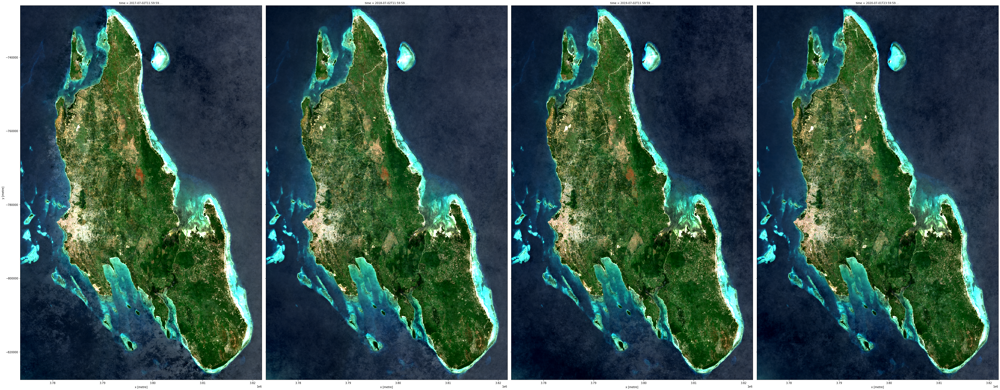

In [10]:
rgb(island_ds, col='time', aspect=.625, size=20)

In [11]:
MNDWI = calculate_indices(island_ds, index = 'MNDWI', collection='s2', drop=True)

Dropping bands ['green', 'red', 'blue', 'swir_1']


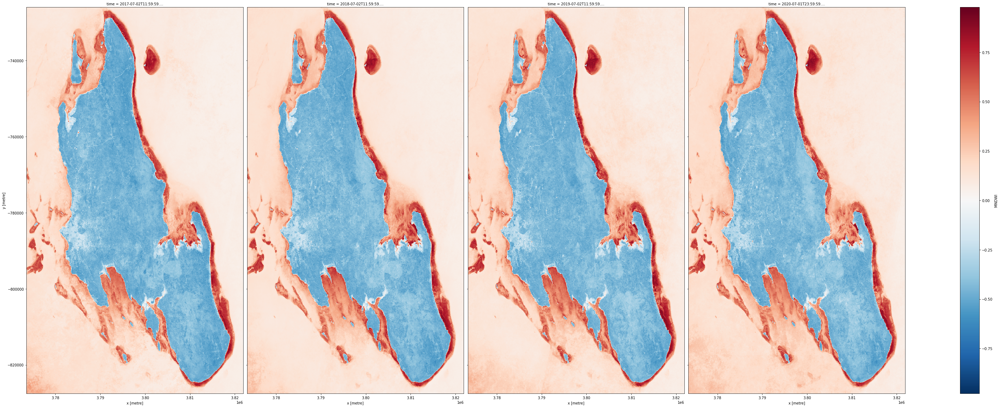

In [12]:
MNDWI.MNDWI.plot(col='time', aspect = .625, figsize=(44,16))
#.where(MNDWI.MNDWI < 0,0)

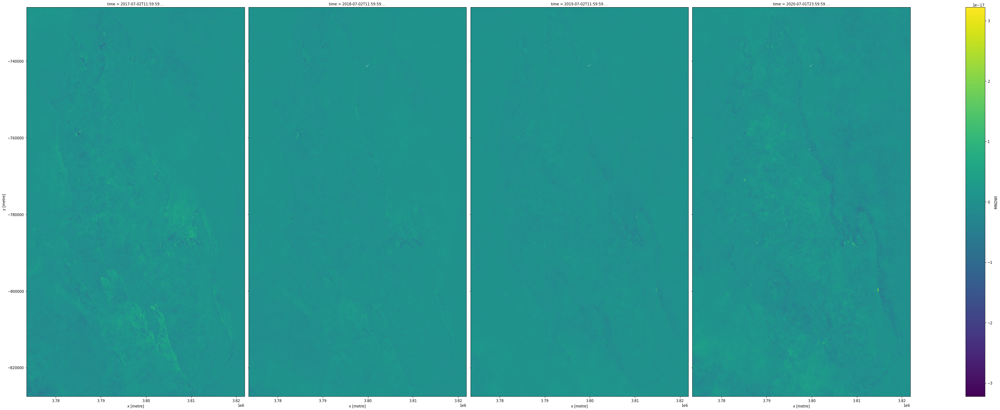

In [13]:
MNDWI.MNDWI.differentiate('time').plot(col='time', aspect = .625, figsize=(44,16),cmap='viridis')

In [36]:
#Areas of interest
#Chwaka Bay
lat = -6.1546
lon = 39.4853
lon_buffer = 0.1
lat_buffer = 0.02

#Uzi lat = -6.383, lon = 39.406, buffer = 0.1
#Nungwi -- Northern Coast lat = -5.7656, lon = 39.3125, buffer = 0.1

#kilmajuu 
lat =  -5.91
lon = 39.365
lat_buffer = 0.1
lon_buffer = 0.02



aoi_lon_range = (lon-lon_buffer,lon+lon_buffer)
aoi_lat_range = (lat-lat_buffer, lat+lat_buffer)

In [37]:
display_map(aoi_lon_range,aoi_lat_range)

In [26]:
start_year = '2017-06'
end_year = '2020-06'

# Create a reusable query
query = {
    'x': aoi_lon_range,
    'y': aoi_lat_range,
    'time': (start_year, end_year),
    'product' : "gm_s2_annual",
    'measurements': ['green',
                     'red',
                     'blue',
                     'swir_1'],
    'resolution': (-10, 10),
    'group_by': 'solar_day',
    'output_crs': 'EPSG:6933'
}

In [27]:
aoi_ds = dc.load(**query)

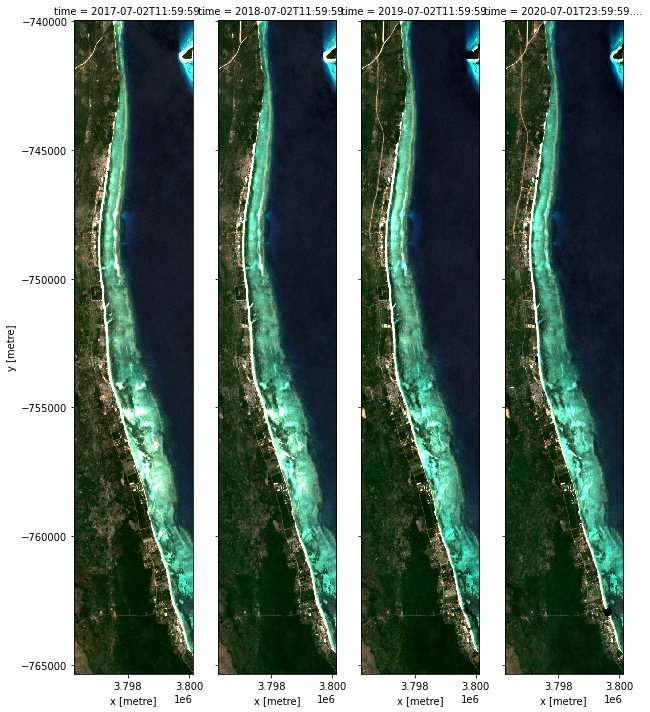

In [28]:
rgb(aoi_ds,col='time', aspect=.2, size=10)

Applying custom image processing functions


  0%|          | 0/4 (0.0 seconds remaining at ? frames/s)

Exporting animation to color_timeseries.gif


  0%|          | 0/4 (0.0 seconds remaining at ? frames/s)

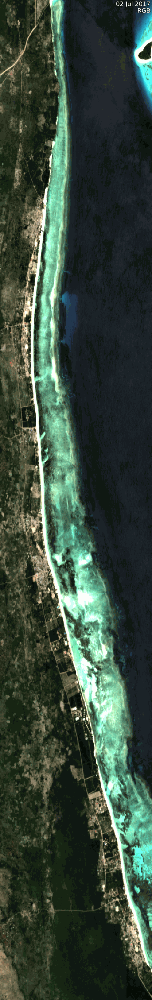

In [33]:
import skimage.exposure
from IPython.display import Image
xr_animation(ds=aoi_ds,
             bands=['red', 'green', 'blue'],
             output_path='color_timeseries.gif',
             show_text='RGB',
             interval= 300,
             image_proc_funcs=[skimage.exposure.rescale_intensity,                               
                               skimage.exposure.equalize_adapthist])
plt.close()

Image(filename='color_timeseries.gif')

In [30]:
aoi_water = calculate_indices(aoi_ds, index='MNDWI', collection= 's2', drop = True)

Dropping bands ['green', 'red', 'blue', 'swir_1']


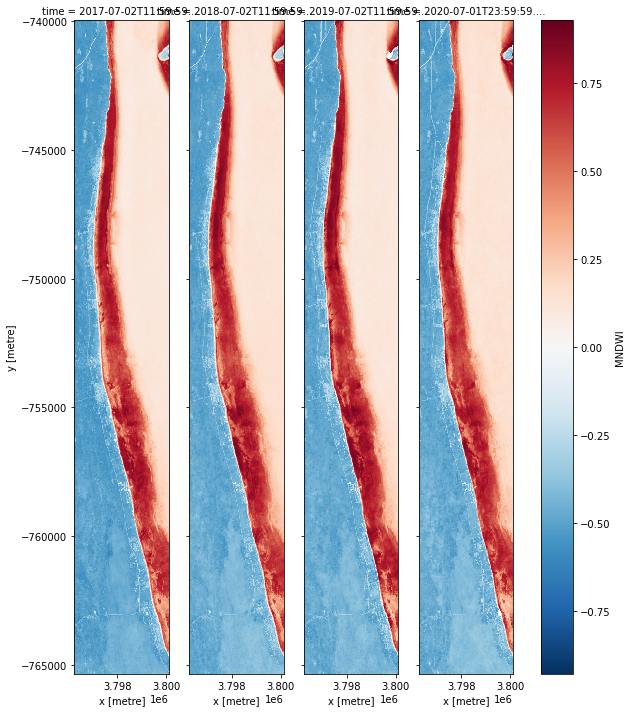

In [31]:
aoi_water.MNDWI.plot(col='time', aspect = .2, size=10)

Exporting animation to water_timeseries.gif


  0%|          | 0/4 (0.0 seconds remaining at ? frames/s)

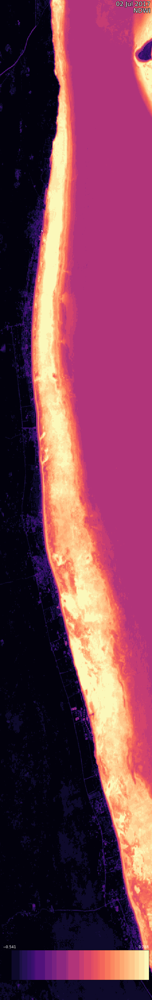

In [35]:
xr_animation(ds=aoi_water,
             bands='MNDWI', 
             output_path='water_timeseries.gif',
             show_text='NDWI',
             interval= 300,)
plt.close()
Image(filename='water_timeseries.gif')

***

## Additional information

**License:** The code in this notebook is licensed under the [Apache License, Version 2.0](https://www.apache.org/licenses/LICENSE-2.0). 
Digital Earth Africa data is licensed under the [Creative Commons by Attribution 4.0](https://creativecommons.org/licenses/by/4.0/) license.

**Contact:** If you need assistance, please post a question on the [Open Data Cube Slack channel](http://slack.opendatacube.org/) or on the [GIS Stack Exchange](https://gis.stackexchange.com/questions/ask?tags=open-data-cube) using the `open-data-cube` tag (you can view previously asked questions [here](https://gis.stackexchange.com/questions/tagged/open-data-cube)).
If you would like to report an issue with this notebook, you can file one on [Github](https://github.com/digitalearthafrica/deafrica-sandbox-notebooks).

**Compatible datacube version:** 

In [7]:
print(datacube.__version__)

1.8.4.dev52+g07bc51a5


**Last Tested:**

In [8]:
from datetime import datetime
datetime.today().strftime('%Y-%m-%d')

'2021-03-02'